**This file has multiple visualizations, most important are crime rates through out the years, Crime Distribution Across Districts, common offence types and groups, spatial plotting of crimes and also specifically for larceny, Distribution of Shooting Incidents Across Districts, Day and Hour Distribution of Shooting Incidents**

In [2]:
import pandas as pd
import glob

# List all CSV files in the current directory
files = glob.glob('Cr20*.csv')

# Initialize an empty DataFrame to store the combined data
combined_data = pd.DataFrame()

# Loop through the files and append them to the combined_data DataFrame
for file in files:
    df = pd.read_csv(file)
    combined_data = combined_data.append(df, ignore_index=True)

# Save the combined data to a new CSV file
combined_data.to_csv('combined_file.csv', index=False)


C:\Users\Exam15\AppData\Local\Temp\ipykernel_9492\1180243297.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  combined_data = combined_data.append(df, ignore_index=True)
C:\Users\Exam15\AppData\Local\Temp\ipykernel_9492\1180243297.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  combined_data = combined_data.append(df, ignore_index=True)
C:\Users\Exam15\AppData\Local\Temp\ipykernel_9492\1180243297.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  combined_data = combined_data.append(df, ignore_index=True)
C:\Users\Exam15\AppData\Local\Temp\ipykernel_9492\1180243297.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  combined

In [3]:
from IPython.display import FileLink

# Display a link to download the file
FileLink('combined_file.csv')


C:\Users\Exam15\combined_file.csv

In [4]:
# Load the combined CSV file into a DataFrame
df = pd.read_csv('combined_file.csv')

# Display the first few rows of the DataFrame
print("First few rows of the DataFrame:")
print(df.head())

# Basic statistics about the numerical columns
print("\nSummary statistics:")
print(df.describe())


C:\Users\Exam15\AppData\Local\Temp\ipykernel_9492\374052180.py:2: DtypeWarning: Columns (0,2,6,12) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('combined_file.csv')


First few rows of the DataFrame:
  INCIDENT_NUMBER  OFFENSE_CODE  OFFENSE_CODE_GROUP  \
0      I172040657          2629          Harassment   
1      I182061268          3201       Property Lost   
2      I162013546          3201       Property Lost   
3      I152051083          3115  Investigate Person   
4      I152059178          2647               Other   

         OFFENSE_DESCRIPTION DISTRICT REPORTING_AREA SHOOTING  \
0                 HARASSMENT      C11            397      NaN   
1            PROPERTY - LOST      NaN                     NaN   
2            PROPERTY - LOST       B3            433      NaN   
3         INVESTIGATE PERSON       A7             20      NaN   
4  THREATS TO DO BODILY HARM      C11            359      NaN   

      OCCURRED_ON_DATE  YEAR  MONTH DAY_OF_WEEK  HOUR    UCR_PART  \
0  2015-06-15 00:00:00  2015      6      Monday     0    Part Two   
1  2015-06-15 00:00:00  2015      6      Monday     0  Part Three   
2  2015-06-15 00:00:00  2015      6   

In [5]:
# Information about the DataFrame, including data types and missing values
print("\nDataFrame information:")
print(df.info())


DataFrame information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 723842 entries, 0 to 723841
Data columns (total 17 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   INCIDENT_NUMBER      723842 non-null  object 
 1   OFFENSE_CODE         723842 non-null  int64  
 2   OFFENSE_CODE_GROUP   353253 non-null  object 
 3   OFFENSE_DESCRIPTION  723842 non-null  object 
 4   DISTRICT             719362 non-null  object 
 5   REPORTING_AREA       723842 non-null  object 
 6   SHOOTING             372044 non-null  object 
 7   OCCURRED_ON_DATE     723842 non-null  object 
 8   YEAR                 723842 non-null  int64  
 9   MONTH                723842 non-null  int64  
 10  DAY_OF_WEEK          723842 non-null  object 
 11  HOUR                 723842 non-null  int64  
 12  UCR_PART             353156 non-null  object 
 13  STREET               711954 non-null  object 
 14  Lat                  683359 non-null  float6

In [6]:
# Check for missing values in the DataFrame
print("\nMissing values:")
print(df.isnull().sum())


Missing values:
INCIDENT_NUMBER             0
OFFENSE_CODE                0
OFFENSE_CODE_GROUP     370589
OFFENSE_DESCRIPTION         0
DISTRICT                 4480
REPORTING_AREA              0
SHOOTING               351798
OCCURRED_ON_DATE            0
YEAR                        0
MONTH                       0
DAY_OF_WEEK                 0
HOUR                        0
UCR_PART               370686
STREET                  11888
Lat                     40483
Long                    40483
Location                40483
dtype: int64


In [7]:
# Unique values in each column
print("\nUnique values in each column:")
for column in df.columns:
    print(f"{column}: {df[column].nunique()} unique values")


Unique values in each column:
INCIDENT_NUMBER: 681769 unique values
OFFENSE_CODE: 254 unique values
OFFENSE_CODE_GROUP: 67 unique values
OFFENSE_DESCRIPTION: 305 unique values
DISTRICT: 14 unique values
REPORTING_AREA: 883 unique values
SHOOTING: 5 unique values
OCCURRED_ON_DATE: 557400 unique values
YEAR: 9 unique values
MONTH: 12 unique values
DAY_OF_WEEK: 7 unique values
HOUR: 24 unique values
UCR_PART: 4 unique values
STREET: 18829 unique values
Lat: 68075 unique values
Long: 67557 unique values
Location: 68926 unique values


In [8]:
# Correlation matrix for numerical columns
correlation_matrix = df.corr()
print("\nCorrelation matrix:")
print(correlation_matrix)


Correlation matrix:
              OFFENSE_CODE      YEAR     MONTH      HOUR       Lat      Long
OFFENSE_CODE      1.000000  0.025484 -0.004348 -0.008032 -0.032806 -0.006710
YEAR              0.025484  1.000000 -0.122315 -0.029707  0.001725 -0.001901
MONTH            -0.004348 -0.122315  1.000000 -0.000198  0.000733  0.001509
HOUR             -0.008032 -0.029707 -0.000198  1.000000 -0.006116 -0.004126
Lat              -0.032806  0.001725  0.000733 -0.006116  1.000000 -0.849567
Long             -0.006710 -0.001901  0.001509 -0.004126 -0.849567  1.000000


C:\Users\Exam15\AppData\Local\Temp\ipykernel_9492\3019231879.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df.corr()


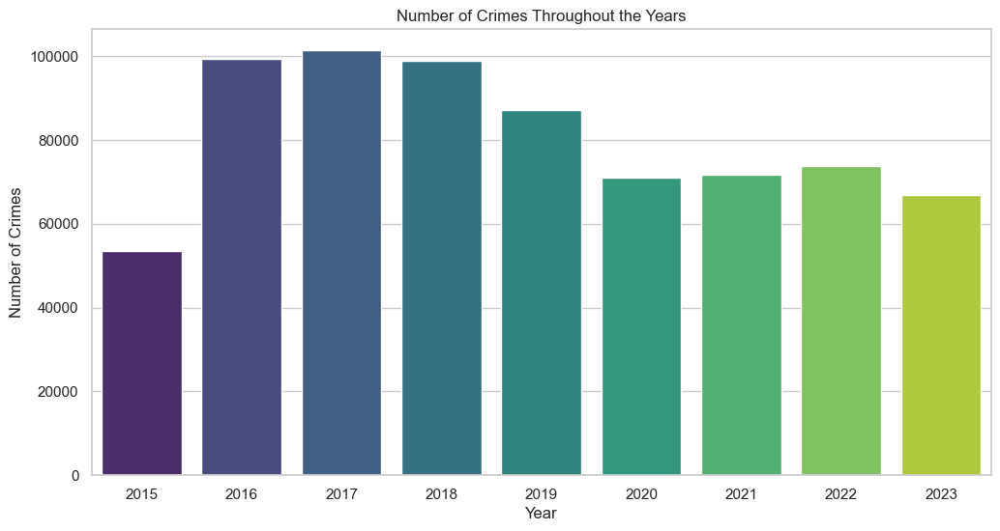

In [9]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the default style for seaborn
sns.set(style="whitegrid")

# Plot for all crimes throughout all years
plt.figure(figsize=(12, 6))
sns.countplot(x='YEAR', data=df, palette='viridis')
plt.title('Number of Crimes Throughout the Years')
plt.xlabel('Year')
plt.ylabel('Number of Crimes')
plt.show()

In [10]:
# Group by offense description and count the occurrences
offense_counts = df['OFFENSE_DESCRIPTION'].value_counts()

# Get the offense with the highest number of occurrences
most_common_offense = offense_counts.idxmax()
highest_occurrences = offense_counts.max()

print(f"The most common offense is '{most_common_offense}' with {highest_occurrences} occurrences.")

The most common offense is 'INVESTIGATE PERSON' with 53375 occurrences.


In [11]:
# Group by offense description and count the occurrences
offense_counts = df['OFFENSE_DESCRIPTION'].value_counts()

# Set the number of top offenses you want to display
top_n = 10

# Get the top N offenses and their occurrence counts
top_offenses = offense_counts.head(top_n)

# Print the top offenses
print(f"Top {top_n} offenses:")
for offense, count in top_offenses.items():
    print(f"{offense}: {count} occurrences")

Top 10 offenses:
INVESTIGATE PERSON: 53375 occurrences
M/V - LEAVING SCENE - PROPERTY DAMAGE: 39622 occurrences
SICK/INJURED/MEDICAL - PERSON: 33800 occurrences
VANDALISM: 32127 occurrences
INVESTIGATE PROPERTY: 29336 occurrences
TOWED MOTOR VEHICLE: 27431 occurrences
VERBAL DISPUTE: 24537 occurrences
SICK ASSIST: 21278 occurrences
ASSAULT SIMPLE - BATTERY: 20247 occurrences
LARCENY SHOPLIFTING: 20141 occurrences


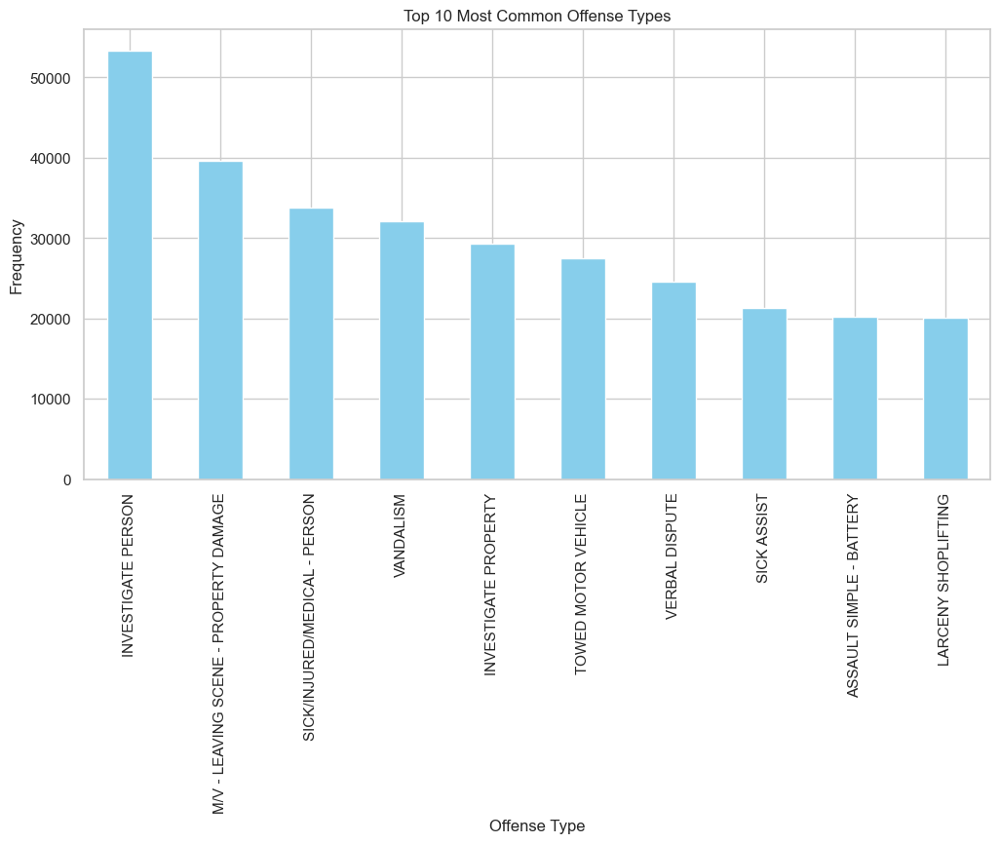

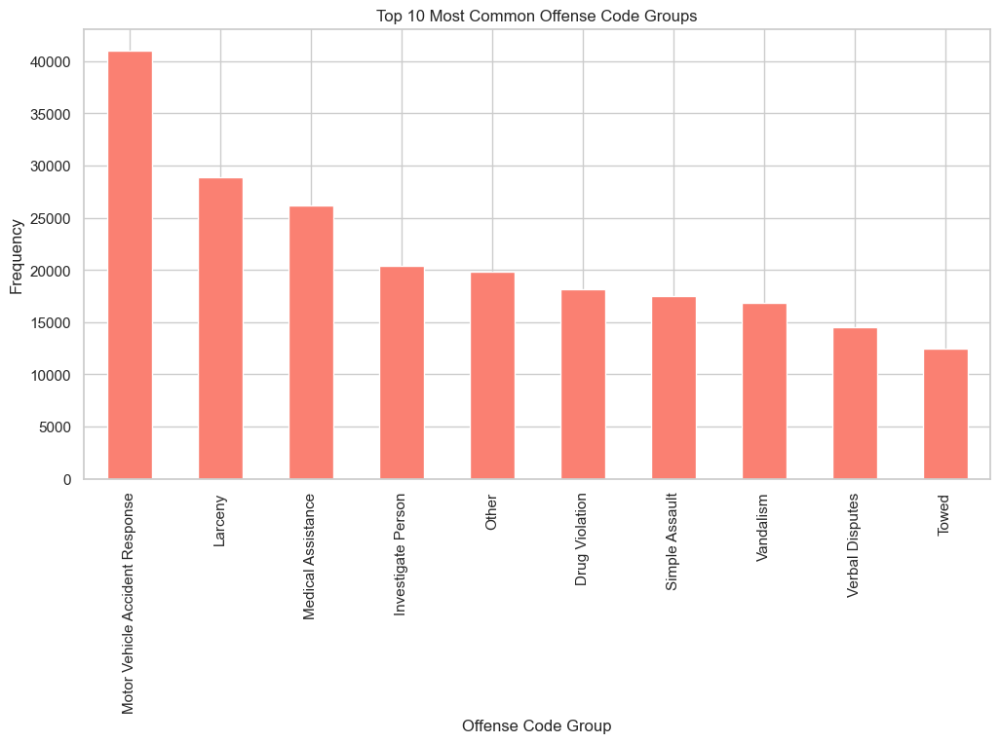

Most Common Offense: INVESTIGATE PERSON, Frequency: 53375
Least Common Offense: B&E NON-RESIDENCE NIGHT - FORCE, Frequency: 1
Most Common Offense Code Group: Motor Vehicle Accident Response, Frequency: 41064
Least Common Offense Code Group: HUMAN TRAFFICKING - INVOLUNTARY SERVITUDE, Frequency: 2


In [12]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming your dataset is loaded into a DataFrame called 'df'
# Replace 'crime_data.csv' with the actual file path if loading from a CSV file
# df = pd.read_csv('crime_data.csv')

# Examine the frequency of different offense types
offense_description_counts = df['OFFENSE_DESCRIPTION'].value_counts()

# Examine the frequency of different offense code groups
offense_code_group_counts = df['OFFENSE_CODE_GROUP'].value_counts()

# Plot the top N offenses
top_n = 10  # You can adjust this value based on how many top offenses you want to visualize

# Plotting the most common offense types
plt.figure(figsize=(12, 6))
offense_description_counts.head(top_n).plot(kind='bar', color='skyblue')
plt.title(f'Top {top_n} Most Common Offense Types')
plt.xlabel('Offense Type')
plt.ylabel('Frequency')
plt.show()

# Plotting the most common offense code groups
plt.figure(figsize=(12, 6))
offense_code_group_counts.head(top_n).plot(kind='bar', color='salmon')
plt.title(f'Top {top_n} Most Common Offense Code Groups')
plt.xlabel('Offense Code Group')
plt.ylabel('Frequency')
plt.show()

# Identify the most common and least common offenses
most_common_offense = offense_description_counts.idxmax()
least_common_offense = offense_description_counts.idxmin()

most_common_code_group = offense_code_group_counts.idxmax()
least_common_code_group = offense_code_group_counts.idxmin()

print(f'Most Common Offense: {most_common_offense}, Frequency: {offense_description_counts.max()}')
print(f'Least Common Offense: {least_common_offense}, Frequency: {offense_description_counts.min()}')

print(f'Most Common Offense Code Group: {most_common_code_group}, Frequency: {offense_code_group_counts.max()}')
print(f'Least Common Offense Code Group: {least_common_code_group}, Frequency: {offense_code_group_counts.min()}')


In [13]:
!pip install folium

import pandas as pd
import folium
from folium.plugins import HeatMap

# Assuming your dataset is loaded into a DataFrame called 'df'
# Replace 'crime_data.csv' with the actual file path if loading from a CSV file
# df = pd.read_csv('crime_data.csv')

# Filter out rows with missing latitude and longitude values
df_map = df.dropna(subset=['Lat', 'Long'])

# Create a base map centered around the mean latitude and longitude
base_map = folium.Map(location=[df_map['Lat'].mean(), df_map['Long'].mean()], zoom_start=12)

# Create a HeatMap layer to visualize crime density
heat_data = [[row['Lat'], row['Long']] for index, row in df_map.iterrows()]
HeatMap(heat_data).add_to(base_map)

# Display the map
base_map.save('crime_heatmap.html')  # Save the map as an HTML file
base_map

In [14]:
offense_group = 'Larceny'
df_group = df[df['OFFENSE_CODE_GROUP'] == offense_group]
df_group_map = df_group.dropna(subset=['Lat', 'Long'])

base_map_group = folium.Map(location=[df_group_map['Lat'].mean(), df_group_map['Long'].mean()], zoom_start=12)
heat_data_group = [[row['Lat'], row['Long']] for index, row in df_group_map.iterrows()]
HeatMap(heat_data_group).add_to(base_map_group)

# Display the map for the specific offense code group
base_map_group.save(f'crime_heatmap_{offense_group.lower()}.html')
base_map_group

In [15]:
import pandas as pd
import folium
from folium.plugins import MarkerCluster

# Assuming your dataset is loaded into a DataFrame called 'df'
# Replace 'crime_data.csv' with the actual file path if loading from a CSV file
# df = pd.read_csv('crime_data.csv')

# Filter out rows with missing 'Location' values
df_map = df.dropna(subset=['Location'])

# Create a base map centered around the mean latitude and longitude
base_map = folium.Map(location=[df_map['Lat'].mean(), df_map['Long'].mean()], zoom_start=12)

# Create a MarkerCluster to group markers for better visualization
marker_cluster = MarkerCluster().add_to(base_map)

# Add markers for each crime incident
for index, row in df_map.iterrows():
    folium.Marker([row['Lat'], row['Long']], popup=f"{row['STREET']} - {row['OFFENSE_DESCRIPTION']}").add_to(marker_cluster)

# Display the map
base_map.save('crime_marker_cluster_map.html')  # Save the map as an HTML file
base_map

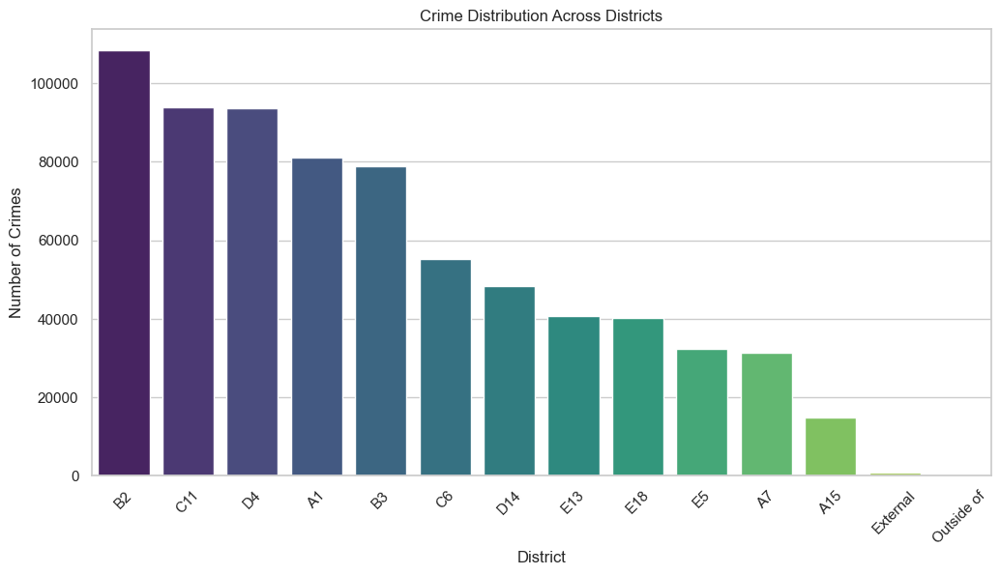

In [19]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming your dataset is loaded into a DataFrame called 'df'
# Replace 'crime_data.csv' with the actual file path if loading from a CSV file
# df = pd.read_csv('crime_data.csv')

# Filter out rows with missing district values
df_district = df.dropna(subset=['DISTRICT'])

# Analyze overall crime distribution across districts
plt.figure(figsize=(12, 6))
sns.countplot(x='DISTRICT', data=df_district, order=df_district['DISTRICT'].value_counts().index, palette='viridis')
plt.title('Crime Distribution Across Districts')
plt.xlabel('District')
plt.ylabel('Number of Crimes')
plt.xticks(rotation=45)
plt.show()


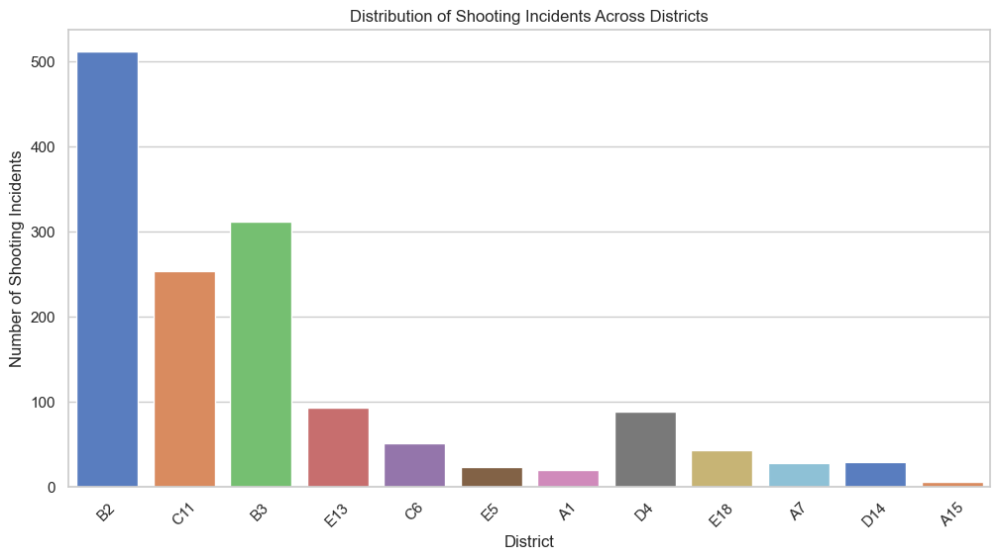

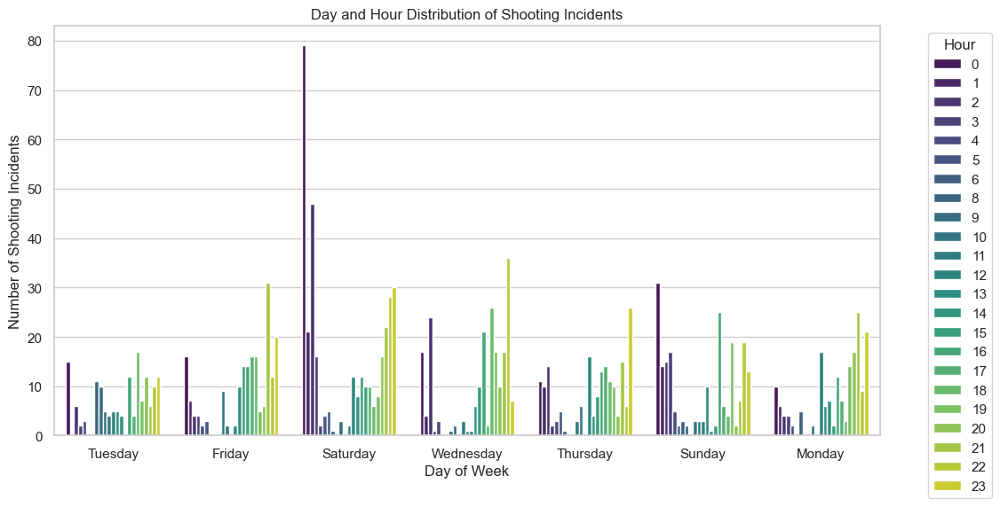

In [17]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming your dataset is loaded into a DataFrame called 'df'
# Replace 'crime_data.csv' with the actual file path if loading from a CSV file
# df = pd.read_csv('crime_data.csv')

# Filter rows with shooting incidents
df_shooting = df[df['SHOOTING'] == 'Y']

# Distribution of shooting incidents across districts
plt.figure(figsize=(12, 6))
sns.countplot(x='DISTRICT', data=df_shooting, palette='muted')
plt.title('Distribution of Shooting Incidents Across Districts')
plt.xlabel('District')
plt.ylabel('Number of Shooting Incidents')
plt.xticks(rotation=45)
plt.show()

# Patterns related to the time and day of shooting incidents
plt.figure(figsize=(12, 6))
sns.countplot(x='DAY_OF_WEEK', hue='HOUR', data=df_shooting, palette='viridis')
plt.title('Day and Hour Distribution of Shooting Incidents')
plt.xlabel('Day of Week')
plt.ylabel('Number of Shooting Incidents')
plt.legend(title='Hour', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


In [41]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming your dataset is loaded into a DataFrame called 'df'
# Replace 'crime_data.csv' with the actual file path if loading from a CSV file
# df = pd.read_csv('crime_data.csv')

# Convert 'OCCURRED_ON_DATE' to datetime format if not already
df['OCCURRED_ON_DATE'] = pd.to_datetime(df['OCCURRED_ON_DATE'], format = 'ISO8601', utc= True)

# Extract hour from the 'OCCURRED_ON_DATE' and create a new column
df['Hour'] = df['OCCURRED_ON_DATE'].dt.hour

# Group by hour and offense description, count the occurrences
offense_by_hour = df.groupby(['Hour', 'OFFENSE_DESCRIPTION']).size().unstack(fill_value=0)

# Identify peak hours for different types of offenses
peak_hours = offense_by_hour.idxmax()

print("Peak Hours for Different Types of Offenses:")
print(peak_hours)

KeyError: 'OCCURRED_ON_DATE'

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming your dataset is loaded into a DataFrame called 'df'
# Replace 'crime_data.csv' with the actual file path if loading from a CSV file
# df = pd.read_csv('crime_data.csv')

# Find the top 5 streets with the highest frequency of crime incidents
top_streets = df['STREET'].value_counts().nlargest(10).index.tolist()

# Filter the dataset for the top 5 streets
df_top_streets = df[df['STREET'].isin(top_streets)]

# Check for missing values in the 'STREET' column
if df_top_streets['STREET'].isnull().any():
    print("Warning: Missing values in the 'STREET' column.")

# Check if there are any rows left after filtering
if df_top_streets.empty:
    print("Warning: No data for the top 5 streets.")
else:
    # Visualize crime incidents on the top 5 streets
    plt.figure(figsize=(12, 6))
    sns.countplot(x='STREET', data=df_top_streets, palette='muted', order=top_streets)
    plt.title('Crime Incidents on Top 10 Streets')
    plt.xlabel('Street')
    plt.ylabel('Number of Incidents')
    plt.xticks(rotation=45)
    plt.show()


In [ ]:
# Assuming your dataset is loaded into a DataFrame called 'df'
# Replace 'crime_data.csv' with the actual file path if loading from a CSV file
# df = pd.read_csv('crime_data.csv')

# Convert 'OCCURRED_ON_DATE' to datetime format if not already
df['OCCURRED_ON_DATE'] = pd.to_datetime(df['OCCURRED_ON_DATE'])

# Extract hour from the 'OCCURRED_ON_DATE' and create a new column
df['Hour'] = df['OCCURRED_ON_DATE'].dt.hour

# Explore potential correlations between different attributes
correlation_matrix = df[['Hour', 'OFFENSE_CODE']].corr()

print("Correlation Matrix:")
print(correlation_matrix)

In [20]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import LabelEncoder, OneHotEncoder

# Drop unnecessary columns for the modeling process
df_model = df.drop(['INCIDENT_NUMBER', 'REPORTING_AREA', 'OCCURRED_ON_DATE', 'UCR_PART', 'Lat', 'Long', 'Location'], axis=1)

# Handle missing values
df_model = df_model.dropna()

# Create a binary target column
df_model['ALERT_STATUS'] = df_model.groupby('STREET')['STREET'].transform('count') > 5

In [21]:
# Convert categorical variables to numerical using Label Encoding or One-Hot Encoding
label_encoder = LabelEncoder()
df_model['DISTRICT'] = label_encoder.fit_transform(df_model['DISTRICT'])
df_model['DAY_OF_WEEK'] = label_encoder.fit_transform(df_model['DAY_OF_WEEK'])
df_model['STREET'] = label_encoder.fit_transform(df_model['STREET'])

# One-hot encode the 'OFFENSE_DESCRIPTION' column
onehot_encoder = OneHotEncoder(sparse=False, drop='first')
offense_description_encoded = onehot_encoder.fit_transform(df_model[['OFFENSE_DESCRIPTION']])
column_names = onehot_encoder.get_feature_names_out(['OFFENSE_DESCRIPTION'])
df_model = pd.concat([df_model, pd.DataFrame(offense_description_encoded, columns=column_names)], axis=1)
df_model = df_model.drop(['OFFENSE_DESCRIPTION'], axis=1)

C:\Users\Exam15\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:972: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


In [22]:
# Create a new binary target variable
df_model['SAFETY_LABEL'] = df_model['DISTRICT'].apply(lambda x: 'Stay Alert' if x in df_model['DISTRICT'].value_counts().index[:3] else 'Safe to Stay')

In [23]:
# Define features (X) and target variable (y)
X = df_model.drop(['SAFETY_LABEL'], axis=1)
y = df_model['SAFETY_LABEL']

In [24]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [39]:
# Initialize the Random Forest Classifier
model = RandomForestClassifier(n_estimators=100, random_state=42)